In [1]:
import pandas as pd
import os
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
sns.set_style("whitegrid")
from tqdm import tqdm
import random
import math as m
import string
from collections import defaultdict


In [2]:
import plotly.figure_factory as ff


In [3]:
import plotly as py
from plotly.offline import iplot
py.offline.init_notebook_mode(connected=True)
import cufflinks as cf
cf.go_offline()

In [4]:
df=pd.read_csv("df.csv")
df.head()

,designation,description,productid,imageid,prdtypecode,target,image_path
0,Olivia: Personalisiertes Notizbuch / 150 Seite...,NaN,3804725264,1263597046,10,0,NaN
1,Journal Des Arts (Le) N° 133 Du 28/09/2001 - L...,NaN,436067568,1008141237,2280,1,NaN
2,Grand Stylet Ergonomique Bleu Gamepad Nintendo...,PILOT STYLE Touch Pen de marque Speedlink est ...,201115110,938777978,50,2,NaN
3,Peluche Donald - Europe - Disneyland 2000 (Mar...,NaN,50418756,457047496,1280,3,NaN
4,La Guerre Des Tuques,Luc a des id&eacute;es de grandeur. Il veut or...,278535884,1077757786,2705,4,NaN


# Création de colonnes supplementaires pour l'exploration de données 

In [5]:
from nltk.corpus import stopwords


stop_words = set(stopwords.words('french'))


In [6]:
string.punctuation

'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

In [7]:
def word_count(x):
    cd=pd.isnull(x)
    if cd==True:
        return np.nan
    else :
        return len(str(x).split()) 
    
def unique_words(x):
    if pd.isnull(x):
        return np.nan
    else :
        return len(set(str(x).split()))
def stop_words_count(x):
    if pd.isnull(x):
        return np.nan
    else :
        return len([w for w in str(x).lower().split() if w in stop_words])
def chart_count(x):
    if pd.isnull(x):
        return np.nan
    else :
        return len(str(x))
def mean_word_length(x):
    if pd.isnull(x):
        return np.nan
    else :
        return len(set(str(x).split()))
    
def punctuation_count(x):
    if pd.isnull(x):
        return np.nan
    else :
        return len([c for c in str(x) if c in string.punctuation])


In [8]:
df['word_count_description'] = df['description'].apply(word_count)
df['word_count_designation'] = df['designation'].apply(word_count)

In [105]:
df['unique_word_count_description'] = df['description'].apply(unique_words)
df['unique_word_count_designation'] = df['designation'].apply(unique_words)

In [10]:
df['chart_count_description'] = df['description'].apply(chart_count)
df['chart_count_designation'] = df['designation'].apply(chart_count)

In [11]:
df['stop_words_count_description'] = df['description'].apply(stop_words_count)
df['stop_words_count_designation'] = df['designation'].apply(stop_words_count)

In [12]:
df['mean_word_length_description'] = df['description'].apply(mean_word_length)
df['mean_word_length_designation'] = df['designation'].apply(mean_word_length)

In [13]:
df['punctuation_count_description'] = df['description'].apply(punctuation_count)
df['punctuation_count_designation'] = df['designation'].apply(punctuation_count)

In [14]:
df.head(3)

,designation,description,productid,imageid,prdtypecode,target,image_path,word_count_description,word_count_designation,unique_word_count_description,unique_word_count_designation,chart_count_description,chart_count_designation,stop_words_count_description,stop_words_count_designation,mean_word_length_description,mean_word_length_designation,punctuation_count_description,punctuation_count_designation
0,Olivia: Personalisiertes Notizbuch / 150 Seite...,NaN,3804725264,1263597046,10,0,NaN,NaN,14,NaN,11,NaN,88,NaN,0,NaN,11,NaN,6
1,Journal Des Arts (Le) N° 133 Du 28/09/2001 - L...,NaN,436067568,1008141237,2280,1,NaN,NaN,39,NaN,34,NaN,206,NaN,9,NaN,34,NaN,12
2,Grand Stylet Ergonomique Bleu Gamepad Nintendo...,PILOT STYLE Touch Pen de marque Speedlink est ...,201115110,938777978,50,2,NaN,109.0,12,88.0,12,760.0,76,31.0,0,88.0,12,51.0,1


In [15]:
df.describe()

,productid,imageid,prdtypecode,target,image_path,word_count_description,word_count_designation,unique_word_count_description,unique_word_count_designation,chart_count_description,chart_count_designation,stop_words_count_description,stop_words_count_designation,mean_word_length_description,mean_word_length_designation,punctuation_count_description,punctuation_count_designation
count,8.491600e+04,8.491600e+04,84916.000000,84916.000000,0.0,55116.000000,84916.000000,55116.000000,84916.000000,55116.000000,84916.000000,55116.000000,84916.000000,55116.000000,84916.000000,55116.000000,84916.000000
mean,2.555468e+09,1.152691e+09,1773.219900,10.974563,NaN,123.510959,11.557374,81.412113,10.706439,808.171692,70.163303,32.652587,1.483808,81.412113,10.706439,49.950287,1.829891
std,1.588656e+09,1.751427e+08,788.179885,6.721224,NaN,123.158437,6.207966,60.652455,5.051102,805.462153,36.793383,38.137597,1.881813,60.652455,5.051102,71.529329,2.602780
min,1.839120e+05,6.728400e+04,10.000000,0.000000,NaN,1.000000,3.000000,1.000000,2.000000,1.000000,11.000000,0.000000,0.000000,1.000000,2.000000,0.000000,0.000000
25%,6.760519e+08,1.056269e+09,1281.000000,5.000000,NaN,39.000000,7.000000,33.000000,7.000000,259.000000,43.000000,6.000000,0.000000,33.000000,7.000000,11.000000,0.000000
50%,3.190506e+09,1.213354e+09,1920.000000,11.000000,NaN,95.000000,11.000000,72.000000,10.000000,626.000000,64.000000,22.000000,1.000000,72.000000,10.000000,27.000000,1.000000
75%,3.995599e+09,1.275646e+09,2522.000000,16.000000,NaN,161.000000,14.000000,113.000000,13.000000,1034.000000,90.000000,47.000000,2.000000,113.000000,13.000000,60.000000,2.000000
max,4.252012e+09,1.328824e+09,2905.000000,26.000000,NaN,2068.000000,56.000000,739.000000,44.000000,12451.000000,250.000000,888.000000,23.000000,739.000000,44.000000,3717.000000,45.000000


# Premières analyses

In [16]:
description_stats=['word_count_description' ,'unique_word_count_description','chart_count_description','stop_words_count_description','mean_word_length_description','punctuation_count_description']
designation_stats=['word_count_designation' ,'unique_word_count_designation','chart_count_designation','stop_words_count_designation','mean_word_length_designation','punctuation_count_designation']


In [17]:
df[designation_stats].iplot(kind='box', title= "Statistiques de la variables designation")

In [18]:
df[description_stats].iplot(kind='box', title= "Statistiques de la variables description")

### On remarque que la colonne designation a globalement beaucoup plus de mots que la colonne descrition (sans tenir compte des NaNs) ,
### Le graphique ci dessous compare les nb de mot et les nb de mot uniques de chacune des variables

In [19]:
word_count=df[[x for x in df.columns if "word_count" in x]]

In [20]:
word_count.iplot(kind='box', title= "word counts for both designation and description")

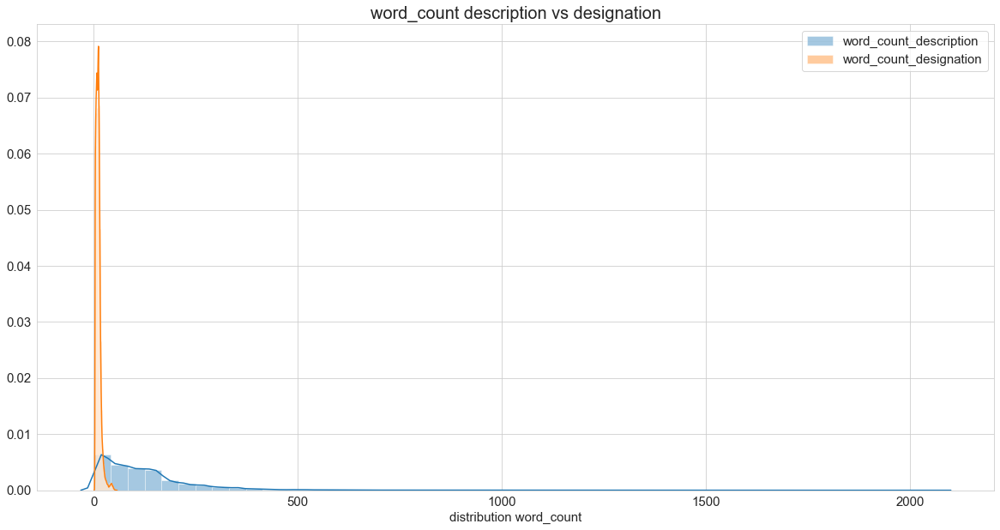

In [41]:
plt.figure(figsize=(20,10))
sns.distplot(word_count.iloc[:,0].values, label=word_count.columns[0])
sns.distplot(word_count.iloc[:,1].values,label=word_count.columns[1])
plt.legend(fontsize=15)
plt.title("word_count description vs designation", fontsize=20)
plt.xlabel("distribution word_count", fontsize=15)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.show()

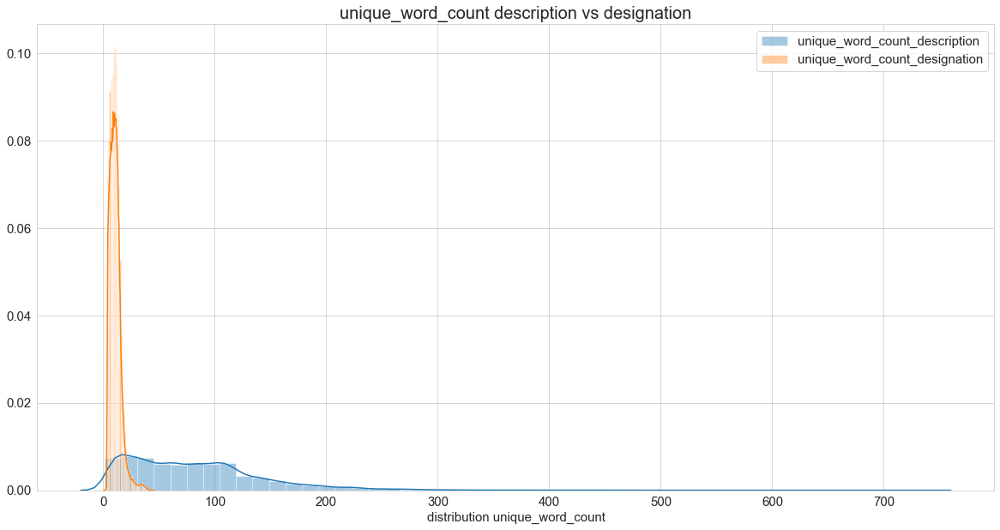

In [45]:
plt.figure(figsize=(20,10))
sns.distplot(word_count.iloc[:,2].values, label=word_count.columns[2])
sns.distplot(word_count.iloc[:,3].values,label=word_count.columns[3])
plt.legend(fontsize=15)
plt.title("unique_word_count description vs designation", fontsize=20)
plt.xlabel("distribution unique_word_count", fontsize=15)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.show()

In [44]:
import plotly.figure_factory as ff
group_labels=[word_count.columns[0],word_count.columns[1]]
fig1 = ff.create_distplot([word_count.dropna().iloc[:,0].values, word_count.iloc[:,1].values],  
                          group_labels, histnorm= '', bin_size=0.5, show_curve=True )
#fig1.update_layout(width=700, bargap=0.01)
fig1.show()

In [49]:
display(df[description_stats].describe())
display(df[designation_stats].describe())

,word_count_description,unique_word_count_description,chart_count_description,stop_words_count_description,mean_word_length_description,punctuation_count_description
count,55116.000000,55116.000000,55116.000000,55116.000000,55116.000000,55116.000000
mean,123.510959,81.412113,808.171692,32.652587,81.412113,49.950287
std,123.158437,60.652455,805.462153,38.137597,60.652455,71.529329
min,1.000000,1.000000,1.000000,0.000000,1.000000,0.000000
25%,39.000000,33.000000,259.000000,6.000000,33.000000,11.000000
50%,95.000000,72.000000,626.000000,22.000000,72.000000,27.000000
75%,161.000000,113.000000,1034.000000,47.000000,113.000000,60.000000
max,2068.000000,739.000000,12451.000000,888.000000,739.000000,3717.000000


,word_count_designation,unique_word_count_designation,chart_count_designation,stop_words_count_designation,mean_word_length_designation,punctuation_count_designation
count,84916.000000,84916.000000,84916.000000,84916.000000,84916.000000,84916.000000
mean,11.557374,10.706439,70.163303,1.483808,10.706439,1.829891
std,6.207966,5.051102,36.793383,1.881813,5.051102,2.602780
min,3.000000,2.000000,11.000000,0.000000,2.000000,0.000000
25%,7.000000,7.000000,43.000000,0.000000,7.000000,0.000000
50%,11.000000,10.000000,64.000000,1.000000,10.000000,1.000000
75%,14.000000,13.000000,90.000000,2.000000,13.000000,2.000000
max,56.000000,44.000000,250.000000,23.000000,44.000000,45.000000


### Un traitement des NaNs par la methode de remplacement (remplacer les NaNs de déscription par désignation) étant donné différences entre les deux variables 

In [ ]:
# Nombre de classe 

### 1) Description

# Etude des N_grams

### Rappel répartition du dataset par target 

In [21]:
repartition=df[["designation", "target"]].groupby(['target'],as_index=False).count().sort_values("designation", ascending=False)

In [22]:
repartition.index=["cat_"+str(x) for x in repartition['target']]
repartition

,target,designation
cat_12,12,10209
cat_7,7,5073
cat_14,14,5045
cat_17,17,4993
cat_5,5,4989
cat_3,3,4870
cat_10,10,4774
cat_1,1,4760
cat_9,9,4303
cat_16,16,3953


In [23]:
repartition['designation'].iplot(kind='bar', colors='red',xTitle="classes", yTitle="count",
                                title= "nb de lignes par classe")

### Data Cleaning : 

In [119]:
import re
import nltk
from nltk.stem.porter import PorterStemmer
from nltk.stem import WordNetLemmatizer

In [182]:
def cleaning_data(x):
    cd=pd.isnull(x)
    if cd==True:
        return x
    else:
        sentences = nltk.sent_tokenize(x)
        lemmatizer = WordNetLemmatizer()

        # Lemmatization
        for i in range(len(sentences)):
            words = nltk.word_tokenize(sentences[i])
            words = [lemmatizer.lemmatize(word) for word in words if word not in set(stopwords.words('french'))]
            sentences[i] = ' '.join(words) 
        sentences=' '.join(sentences)
        # on retire les balises html
        sentences=re.sub('<[^<]+?>', '', sentences)
       
        return sentences
     

In [183]:
cleaning_data(df.loc[2,"description"])

"PILOT STYLE Touch Pen marque Speedlink 1 stylet ergonomique GamePad Nintendo Wii U.  Pour confort optimal précision maximale GamePad Wii U : grand stylet hautement ergonomique non seulement parfaitement adapté main aussi très élégant.  Il livré support fixe sans adhésif l'arrière GamePad   Caractéristiques :  Modèle : Speedlink PILOT STYLE Touch Pen  Couleur : Bleu  Ref . Fabricant : SL-3468-BE  Compatibilité : GamePad Nintendo Wii U  Forme particulièrement ergonomique excellente tenue main  Pointe revêtement longue durée conçue abîmer l'écran tactile  En bonus : Support inclu GamePad     "

In [184]:
df["clean_designation"]=df["designation"].apply(cleaning_data)

In [189]:
df["clean_description"]=df["description"].apply(cleaning_data)

In [190]:
df.to_csv("df_clean.csv",index=False)

In [191]:
df.head()

,designation,description,productid,imageid,prdtypecode,target,image_path,word_count_description,word_count_designation,unique_word_count_description,...,chart_count_designation,stop_words_count_description,stop_words_count_designation,mean_word_length_description,mean_word_length_designation,punctuation_count_description,punctuation_count_designation,corpus,clean_designation,clean_description
0,Olivia: Personalisiertes Notizbuch / 150 Seite...,NaN,3804725264,1263597046,10,0,NaN,NaN,14,NaN,...,88,NaN,0,NaN,11,NaN,6,Olivia: Personalisiertes Notizbuch / 150 Seite...,Olivia : Personalisiertes Notizbuch / 150 Seit...,NaN
1,Journal Des Arts (Le) N° 133 Du 28/09/2001 - L...,NaN,436067568,1008141237,2280,1,NaN,NaN,39,NaN,...,206,NaN,9,NaN,34,NaN,12,Journal Des Arts (Le) N° 133 Du 28/09/2001 - L...,Journal Des Arts ( Le ) N° 133 Du 28/09/2001 -...,NaN
2,Grand Stylet Ergonomique Bleu Gamepad Nintendo...,PILOT STYLE Touch Pen de marque Speedlink est ...,201115110,938777978,50,2,NaN,109.0,12,88.0,...,76,31.0,0,88.0,12,51.0,1,PILOT STYLE Touch Pen de marque Speedlink est ...,Grand Stylet Ergonomique Bleu Gamepad Nintendo...,PILOT STYLE Touch Pen marque Speedlink 1 style...
3,Peluche Donald - Europe - Disneyland 2000 (Mar...,NaN,50418756,457047496,1280,3,NaN,NaN,10,NaN,...,63,NaN,1,NaN,9,NaN,4,Peluche Donald - Europe - Disneyland 2000 (Mar...,Peluche Donald - Europe - Disneyland 2000 ( Ma...,NaN
4,La Guerre Des Tuques,Luc a des id&eacute;es de grandeur. Il veut or...,278535884,1077757786,2705,4,NaN,34.0,4,30.0,...,20,14.0,2,30.0,4,15.0,0,Luc a des id&eacute;es de grandeur. Il veut or...,La Guerre Des Tuques,Luc a id & eacute ; grandeur . Il veut organis...


### Text entier Corpus

### Fusion des colonnes description & designation pour avoir toutes les données text

In [193]:
def corpus(x,y):
    cx=pd.isnull(x)
    cy=pd.isnull(y)
    if cx==True:
        return y
    elif cy==True:
        return x
    else :
        return x+y 
    

In [194]:
df['corpus']=df.apply(lambda x: corpus(x['clean_description'], x['clean_designation']), axis=1)

In [195]:
df.head(3)

,designation,description,productid,imageid,prdtypecode,target,image_path,word_count_description,word_count_designation,unique_word_count_description,...,chart_count_designation,stop_words_count_description,stop_words_count_designation,mean_word_length_description,mean_word_length_designation,punctuation_count_description,punctuation_count_designation,corpus,clean_designation,clean_description
0,Olivia: Personalisiertes Notizbuch / 150 Seite...,NaN,3804725264,1263597046,10,0,NaN,NaN,14,NaN,...,88,NaN,0,NaN,11,NaN,6,Olivia : Personalisiertes Notizbuch / 150 Seit...,Olivia : Personalisiertes Notizbuch / 150 Seit...,NaN
1,Journal Des Arts (Le) N° 133 Du 28/09/2001 - L...,NaN,436067568,1008141237,2280,1,NaN,NaN,39,NaN,...,206,NaN,9,NaN,34,NaN,12,Journal Des Arts ( Le ) N° 133 Du 28/09/2001 -...,Journal Des Arts ( Le ) N° 133 Du 28/09/2001 -...,NaN
2,Grand Stylet Ergonomique Bleu Gamepad Nintendo...,PILOT STYLE Touch Pen de marque Speedlink est ...,201115110,938777978,50,2,NaN,109.0,12,88.0,...,76,31.0,0,88.0,12,51.0,1,PILOT STYLE Touch Pen marque Speedlink 1 style...,Grand Stylet Ergonomique Bleu Gamepad Nintendo...,PILOT STYLE Touch Pen marque Speedlink 1 style...


In [196]:

corpus=' '.join(df['corpus'].tolist())

In [197]:
def generate_ngrams(text, n_gram=1):
    token = [token for token in text.lower().split(' ') if token != '' if token not in stop_words]
    ngrams = zip(*[token[i:] for i in range(n_gram)])
    return [' '.join(ngram) for ngram in ngrams]

In [206]:
unigrams_corpus =defaultdict(int) 
for text in df['corpus']:
    for word in generate_ngrams(text):
        unigrams_corpus[word] += 1

No handles with labels found to put in legend.


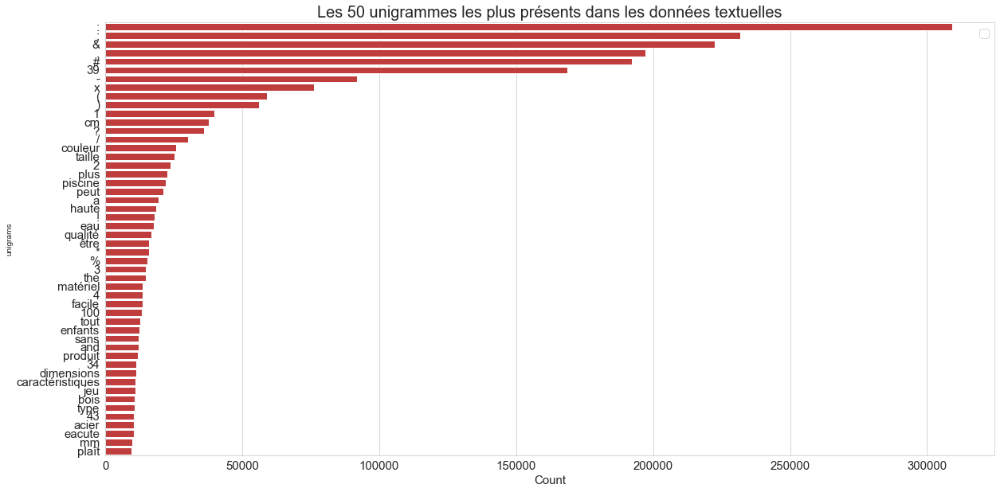

In [207]:
keys = list(unigrams_corpus.keys())
vals = [unigrams_corpus[k] for k in keys]
unigrams=pd.DataFrame( columns=['unigrams', "count"])
unigrams['unigrams']=keys
unigrams['count']=vals
unigrams = unigrams.sort_values(['count'], ascending=False).reset_index(drop=True)
plt.figure(figsize=(20,10))
sns.barplot(y=unigrams['unigrams'][:50], x=unigrams['count'][:50],color = "C3")
plt.legend(fontsize=15)
plt.title("Les 50 unigrammes les plus présents dans les données textuelles", fontsize=20)
plt.xlabel("Count", fontsize=15)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.show()


No handles with labels found to put in legend.


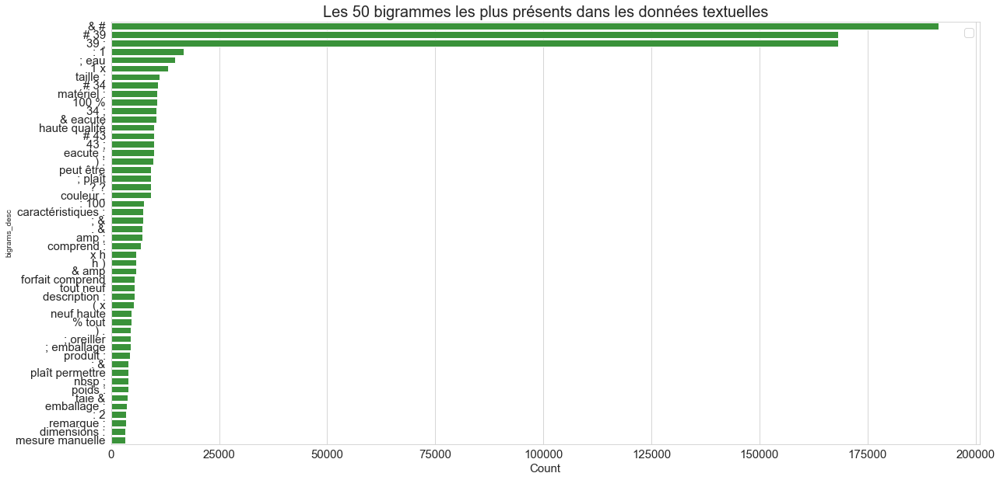

In [210]:
bigrams =defaultdict(int) 
for text in df['corpus']:
    for word in generate_ngrams(text,2):
        bigrams[word] += 1

keys = list(bigrams.keys())
vals = [bigrams[k] for k in keys]
bigrams_df=pd.DataFrame( columns=['bigrams_desc', "count"])
bigrams_df['bigrams_desc']=keys
bigrams_df['count']=vals
bigrams_df = bigrams_df.sort_values(['count'], ascending=False).reset_index(drop=True)
plt.figure(figsize=(20,10))
sns.barplot(y=bigrams_df['bigrams_desc'][:50], x=bigrams_df['count'][:50], color='C2')
plt.legend(fontsize=15)
plt.title("Les 50 bigrammes les plus présents dans les données textuelles", fontsize=20)
plt.xlabel("Count", fontsize=15)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.show()


#### Ces analyses on été réalisées sur les données nettoyées (avec la fonction vue plus haut) => les mots comme "& " "#" n'ont pas été retirés, il faut nettoyer davantage les données 

#### Sur les données non nottoyées et en distingant désignation et description , nous arrivons a avoir plus d'information 

No handles with labels found to put in legend.


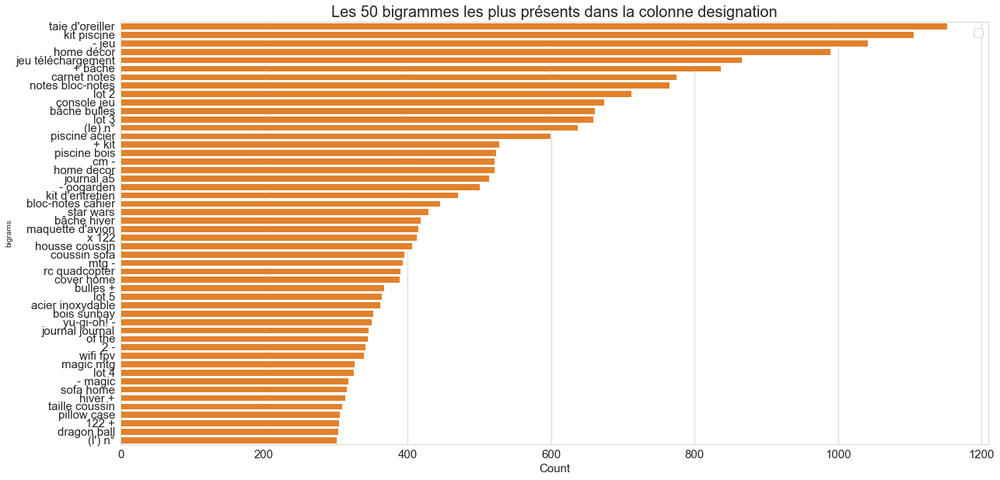

In [213]:
bigrams_desi =defaultdict(int) 
for text in df['designation']:
    for word in generate_ngrams(text,2):
        bigrams_desi[word] += 1

keys = list(bigrams_desi.keys())
vals = [bigrams_desi[k] for k in keys]
bigrams_df=pd.DataFrame( columns=['bigrams', "count"])
bigrams_df['bigrams']=keys
bigrams_df['count']=vals
bigrams_df = bigrams_df.sort_values(['count'], ascending=False).reset_index(drop=True)
plt.figure(figsize=(20,10))
sns.barplot(y=bigrams_df['bigrams'][:50], x=bigrams_df['count'][:50], color='C1')
plt.legend(fontsize=15)
plt.title("Les 50 bigrammes les plus présents dans la colonne designation", fontsize=20)
plt.xlabel("Count", fontsize=15)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.show()

No handles with labels found to put in legend.


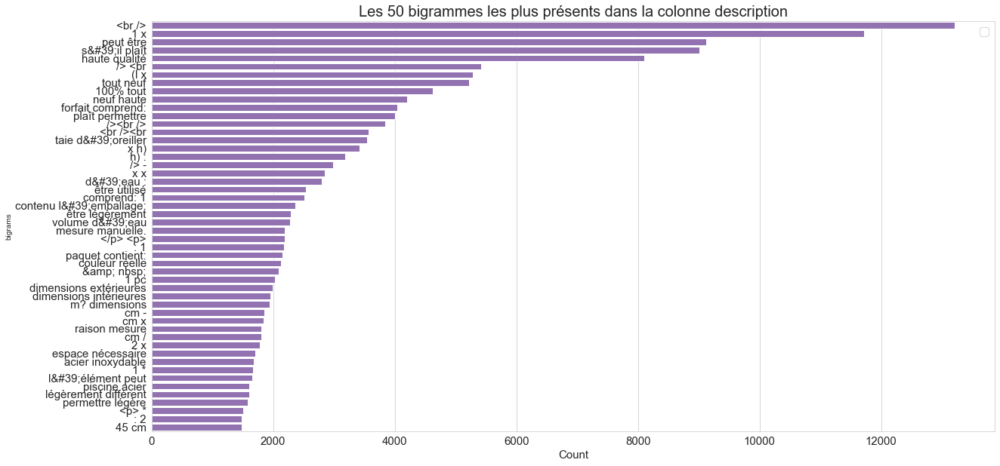

In [217]:
bigrams_desc =defaultdict(int) 
for text in df['description'].dropna():
    for word in generate_ngrams(text,2):
        bigrams_desc[word] += 1

keys = list(bigrams_desc.keys())
vals = [bigrams_desc[k] for k in keys]
bigrams_df=pd.DataFrame( columns=['bigrams', "count"])
bigrams_df['bigrams']=keys
bigrams_df['count']=vals
bigrams_df = bigrams_df.sort_values(['count'], ascending=False).reset_index(drop=True)
plt.figure(figsize=(20,10))
sns.barplot(y=bigrams_df['bigrams'][:50], x=bigrams_df['count'][:50], color='C4')
plt.legend(fontsize=15)
plt.title("Les 50 bigrammes les plus présents dans la colonne description", fontsize=20)
plt.xlabel("Count", fontsize=15)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.show()

#### Unigrams, et bigrams par classe

In [218]:
# Unigrams
unigrams_per_class ={}
for target in tqdm( df['target'].unique()):
    unigrams_per_class[target]=defaultdict(int)
   
    for text in df[df['target']==target]['corpus'].dropna():
       
        for word in generate_ngrams(text):
            
            unigrams_per_class[target][word] += 1

# bigrams
bigrams_per_class ={}
for target in tqdm( df['target'].unique()):
    bigrams_per_class[target]=defaultdict(int)
   
    for text in df[df['target']==target]['corpus'].dropna():
       
        for word in generate_ngrams(text,2):
            
            bigrams_per_class[target][word] += 1

100%|██████████████████████████████████████████████████████████████████████████████████| 27/27 [00:11<00:00,  2.41it/s]


#### Unigrams par class 

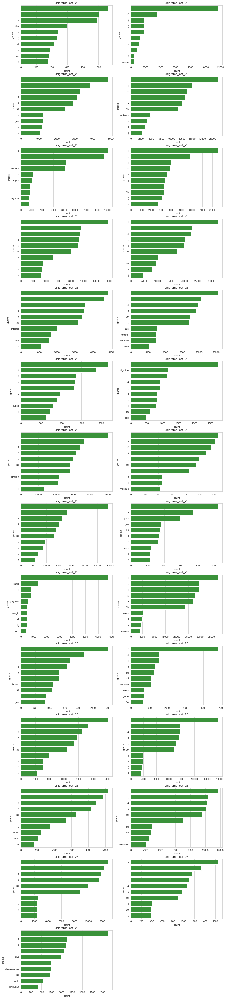

In [240]:
fig = plt.figure(figsize=(14,70))

#plt.subplots(14, 2,  figsize=(10,7))
#fig.suptitle('Unigrams par classe')
a = 14  # number of rows
b = 2  # number of columns
c = 1
for i, key in enumerate(list(unigrams_per_class.keys())):
    keys = list(unigrams_per_class[key].keys())
    vals = [unigrams_per_class[key][mot] for mot in keys]
    grams_df=pd.DataFrame( columns=['grams', "count"])
    grams_df['grams']=keys
    grams_df['count']=vals
    grams_df = grams_df.sort_values(['count'], ascending=False).reset_index(drop=True)
    plt.subplot(a, b, c)
    sns.barplot( y=grams_df['grams'][:10], x=grams_df['count'][:10], color="C2")
    plt.title("unigrams_cat_"+str(k))
    c+=1


#### Brigrams par class

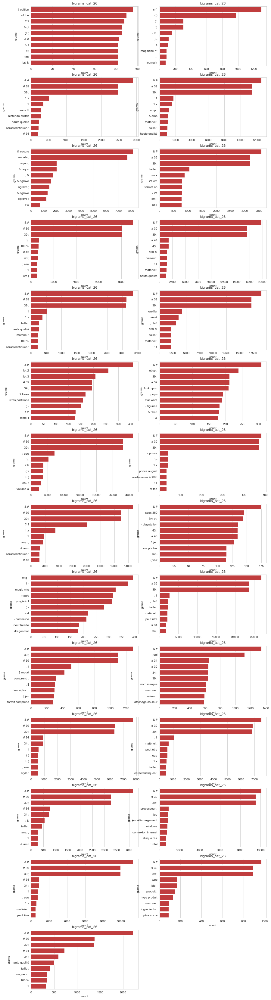

In [241]:
fig = plt.figure(figsize=(14,60))

#plt.subplots(14, 2,  figsize=(10,7))
#fig.suptitle('Unigrams par classe')
a = 14  # number of rows
b = 2  # number of columns
c = 1
for i, key in enumerate(list(bigrams_per_class.keys())):
    keys = list(bigrams_per_class[key].keys())
    vals = [bigrams_per_class[key][mot] for mot in keys]
    grams_df=pd.DataFrame( columns=['grams', "count"])
    grams_df['grams']=keys
    grams_df['count']=vals
    grams_df = grams_df.sort_values(['count'], ascending=False).reset_index(drop=True)
    plt.subplot(a, b, c)
    sns.barplot( y=grams_df['grams'][:10], x=grams_df['count'][:10], color="C3")
    plt.title("bigrams_cat_"+str(k))
    c+=1


### Il faudrait que l'on clean un peu plus les données 

# Est ce qu'il serait utile de faire l'exercice en distingant "designation" et "description"

### 1) Desicription

In [25]:
# Unigrams
unigrams_desc ={}
for target in tqdm( df['target'].unique()):
    unigrams_desc[target]=defaultdict(int)
   
    for text in df[df['target']==target]['description'].dropna():
       
        for word in generate_ngrams(text):
            
            unigrams_desc[target][word] += 1

# bigrams
bigrams_desc ={}
for target in tqdm( df['target'].unique()):
    bigrams_desc[target]=defaultdict(int)
   
    for text in df[df['target']==target]['description'].dropna():
       
        for word in generate_ngrams(text,2):
            
            bigrams_desc[target][word] += 1

100%|██████████████████████████████████████████████████████████████████████████████████| 27/27 [00:03<00:00,  7.38it/s]


In [26]:
for k in unigrams_desc.keys():
    print(k, ":  " , len(bigrams_desc[k]))
    

0 :   6405
1 :   7957
2 :   48884
3 :   161748
4 :   137280
5 :   57675
6 :   114201
7 :   192292
8 :   68739
9 :   55912
10 :   2984
11 :   11130
12 :   171537
13 :   8193
14 :   174105
15 :   1571
16 :   3450
17 :   178363
18 :   28011
19 :   9623
20 :   74597
21 :   86551
22 :   36592
23 :   135460
24 :   109049
25 :   19099
26 :   11861


### 2) Designation

In [27]:
# Unigrams
unigrams ={}
for target in tqdm( df['target'].unique()):
    unigrams[target]=defaultdict(int)
   
    for text in df[df['target']==target]['designation']:
       
        for word in generate_ngrams(text):
            
            unigrams[target][word] += 1

100%|██████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 46.47it/s]


In [28]:
# bigrams
bigrams ={}
for target in tqdm( df['target'].unique()):
    bigrams[target]=defaultdict(int)
   
    for text in df[df['target']==target]['designation']:
       
        for word in generate_ngrams(text,2):
            
            bigrams[target][word] += 1

100%|██████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 38.63it/s]


In [79]:
dico

{'olivia:': 1}